### import required packages, declare utility functions

In [5]:
from histolab.slide import Slide
import os
# from IPython.display import display
from IPython.display import Image, display
import numpy as np
from histolab.tiler import GridTiler

from histolab.tiler import ScoreTiler

from histolab.scorer import RandomScorer

from histolab.scorer import Scorer

from histolab.tile import Tile

from histolab.filters.morphological_filters import RemoveSmallHoles, RemoveSmallObjects
from histolab.masks import TissueMask
from histolab.slide import Slide

import cv2
import numpy as np
import matplotlib.pyplot as plt
import pandas as pd

from histolab.filters.image_filters import (
   ApplyMaskImage,
   Invert,
   OtsuThreshold,
   RgbToGrayscale,
)

class RandomScorer(Scorer):
    """Implement a Scorer that returns a random float score between 0 and 1.

    .. automethod:: __call__
    """
    def __call__(self, tile: Tile) -> float:
        """Return the random score associated with the tile.

        Parameters
        ----------
        tile : Tile
            The tile to calculate the score from.

        Returns
        -------
        float
            Random score ranging between 0 and 1.
        """
        return np.random.random()
    
orig_window = 296


def create_labels(img_list, img_dir, i, orig_window):
    data_list = [] 
    data_dict = {}
#     new_dir = os.path.join(os.path.abspath(os.path.join(img_dir, os.pardir)),f"HE_BC{30000+i}/")
#     os.rename(img_dir, new_dir)
    for img in img_list:
        print(img)
        if img.endswith(".tif"):
            info = img.split("_")
            coord_info = info[3].split("-")
            col = int(coord_info[0])//orig_window
            row = int(coord_info[1])//orig_window
            # BC30001_99_59.tif

            data_dict = {"label": f"BC{30000+i}", "x_coords" : col, "y_coords" : row, "x_pixel_coords" : coord_info[0], "y_pixel_coords" : coord_info[1]}
            data_list.append(data_dict)
#             print(os.path.join(new_dir, f"{data_dict['label']}_{col}_{row}.tif"))
            os.rename(os.path.join(img_dir, img), os.path.join(img_dir, f"{data_dict['label']}_{col}_{row}.tif"))
    df = pd.DataFrame(data_list)
    df.to_csv(os.path.join(img_dir,"..", f"BC{30000+i}_labels.csv"))
    print(f"BC{30000+i}_labels.csv Saved")




In [5]:
# !pip install histolab
# !pip install openslide-python
# apt-get install openslide-tools

P@ssword123
[sudo] password for leecong: 


In [37]:
# import os
# import pandas as pd

# labeled_files = "~/ST-Net/TCGA_preprocess/TCGA_map/selected_labels_filter.tsv"
# df = pd.read_table(labeled_files)
# # print(df.head())
# extremes_dict = df.to_dict()
# print(extremes_dict)

# def tiling_multi(base_dir, output_dir, gene = "ALB"):

#     i = 10
#     files = []
#     for level in ['top', 'bot']:
#         zipped_names = extremes_dict[f'{gene}_{level}_fnames'].items()
#         zipped_names = sorted(zipped_names, key = lambda zipped_names: zipped_names[0])
#         files_half = [v for k, v in zipped_names]
#         files.extend(files_half)

#     for fpath in files:
#         print(i, ":", os.path.basename(fpath))
#         i+=1
# #         PROCESS_PATH_TCGA = output_dir
        
        
# tiling_multi("./ALB_images", "./ALB_tiled")

# # 5,2,4
# # 10,11,15

# # 1,3,6
# # 12, 14, 13


{'ALB_top_names': {0: 'b89c4049-eeac-4f22-a9b6-18ffd9f07132.rna_seq.augmented_star_gene_counts.tsv', 1: 'cfa0d88b-5da4-41be-b3df-7b567a6fef9c.rna_seq.augmented_star_gene_counts.tsv', 2: '5e8476a1-5aa4-48d6-b4a8-d76e52a18d43.rna_seq.augmented_star_gene_counts.tsv', 3: '03ca605c-a693-44da-86b9-4f48c2649839.rna_seq.augmented_star_gene_counts.tsv', 4: '9262c029-3b86-4582-82a1-ace640871d9c.rna_seq.augmented_star_gene_counts.tsv', 5: 'e2288704-0fb1-41cc-82f8-b73e41ebb576.rna_seq.augmented_star_gene_counts.tsv', 6: '286b5e5d-29d0-4033-9f0b-2ae0cb3fa397.rna_seq.augmented_star_gene_counts.tsv', 7: 'bc96f6df-c22f-459a-a712-be9df674b3f0.rna_seq.augmented_star_gene_counts.tsv', 8: '1dc8062e-ec15-4146-a586-112cf061e620.rna_seq.augmented_star_gene_counts.tsv', 9: '0dac8c60-2d8f-46cd-b970-d0cd524374c7.rna_seq.augmented_star_gene_counts.tsv'}, 'ALB_top_fnames': {0: '/home/leecong/TCGA_high_low/TCGA_LIHC_top10_ALB/TCGA-DD-AADA-01Z-00-DX1.9008B43F-5955-44BB-9CDE-0294750C6F09.svs', 1: '/home/leecong/TCGA

In [36]:
# gene = "CD74"
# files = []
# for level in ['top', 'bot']:
#     zipped_names = extremes_dict[f'{gene}_{level}_fnames'].items()
#     zipped_names = sorted(zipped_names, key = lambda zipped_names: zipped_names[0])
#     files_half = [v for k, v in zipped_names]
#     files.extend(files_half)
    
# print(len(files))

# # gene_high = [v for k, v in zipped_names]

# list(extremes_dict['CD74_bot_fnames'].items())



20


[(0,
  '/home/leecong/TCGA_high_low/TCGA_LIHC_lowest10_CD74/TCGA-FV-A496-01Z-00-DX1.A74E56AD-6716-4BE0-80EA-8EFF3CBE0BCE.svs'),
 (1,
  '/home/leecong/TCGA_high_low/TCGA_LIHC_lowest10_CD74/TCGA-DD-AAE6-01Z-00-DX1.A8DE9B19-8C85-47AE-A32A-38AB6F696CE3.svs'),
 (2,
  '/home/leecong/TCGA_high_low/TCGA_LIHC_lowest10_CD74/TCGA-CC-A8HV-01Z-00-DX1.28E50E5D-B742-4FFC-A52F-900F907FBADA.svs'),
 (3,
  '/home/leecong/TCGA_high_low/TCGA_LIHC_lowest10_CD74/TCGA-BC-A10Z-01Z-00-DX1.4AB6A0FC-31FD-4399-B58B-EAB6953AFBFE.svs'),
 (4,
  '/home/leecong/TCGA_high_low/TCGA_LIHC_lowest10_CD74/TCGA-DD-A3A4-01Z-00-DX1.A79D22BF-3D01-47F8-BFDC-E761FED7A663.svs'),
 (5,
  '/home/leecong/TCGA_high_low/TCGA_LIHC_lowest10_CD74/TCGA-DD-A73D-01Z-00-DX1.455790BB-767B-458D-A90E-046FD47D0A92.svs'),
 (6,
  '/home/leecong/TCGA_high_low/TCGA_LIHC_lowest10_CD74/TCGA-CC-A7IL-01Z-00-DX1.73B59FCC-40C9-40F4-AC8A-EBBEB5884757.svs'),
 (7,
  '/home/leecong/TCGA_high_low/TCGA_LIHC_lowest10_CD74/TCGA-DD-A3A2-01Z-00-DX1.19C972E3-0FE2-4E70-9

In [5]:
# # import os
# # def tiling_multi(base_dir, output_dir):

# #     i = 10

# #     for fname in os.listdir(base_dir):
# #         TCGA_PATH = os.path.join(base_dir, fname)
# #         print(i, ":", fname)
# #         i+=1
# # #         PROCESS_PATH_TCGA = output_dir
        
        
# # tiling_multi("/home/sam/Desktop/astar/TCGA_test/ALB", "/home/sam/Desktop/astar/TCGA_test/ALB_tiled")

# # from histolab.data import breast_tissue_diagnostic_green_pen
# seed = 0
# np.random.seed(seed) 

# def tiling_multi(base_dir, output_dir):

#     i = 10

#     for fname in os.listdir(base_dir):
#         TCGA_PATH = os.path.join(base_dir, fname)
#         PROCESS_PATH_TCGA = output_dir

#         TCGA_slide = Slide(TCGA_PATH, processed_path=PROCESS_PATH_TCGA)


In [8]:
# from matplotlib import pyplot as plt
# %matplotlib inline 
# from PIL import Image


# import os
# def tiling_multi(base_dir, output_dir):
#     i = 10

#     for fname in os.listdir(base_dir):
#         print(fname)
#         TCGA_PATH = os.path.join(base_dir, fname)
#         print(i, ":", fname)
#         i+=1
#         PROCESS_PATH_TCGA = output_dir
#         TCGA_slide = Slide(TCGA_PATH, processed_path=PROCESS_PATH_TCGA)
#         data = TCGA_slide.resampled_array(scale_factor=32)
#         im = Image.fromarray(data)        
#         im.show()
# #         im.save(os.path.join(output_dir,f'HE_BC{30000+i}.tif'))
# #         i +=1 

        
        
# tiling_multi("/home/sam/Desktop/astar/TCGA_test/ALB", "/home/sam/Desktop/astar/TCGA_test/ALB_thumb")


TCGA-DD-AAD3-01Z-00-DX1.DB86DCF0-4571-4E47-BDA5-FFD44D7D950E.svs
10 : TCGA-DD-AAD3-01Z-00-DX1.DB86DCF0-4571-4E47-BDA5-FFD44D7D950E.svs
TCGA-CC-5258-01Z-00-DX1.5183124B-973C-4583-B9E0-FB7015E2DC1B.svs
11 : TCGA-CC-5258-01Z-00-DX1.5183124B-973C-4583-B9E0-FB7015E2DC1B.svs
TCGA-CC-A3M9-01Z-00-DX1.64A68473-D774-44E0-9569-BD3FECAC6C19.svs
12 : TCGA-CC-A3M9-01Z-00-DX1.64A68473-D774-44E0-9569-BD3FECAC6C19.svs
TCGA-DD-A3A6-01Z-00-DX1.FCF4A7E7-A0F9-4B5D-B751-D990703EA261.svs
13 : TCGA-DD-A3A6-01Z-00-DX1.FCF4A7E7-A0F9-4B5D-B751-D990703EA261.svs
TCGA-CC-A7IJ-01Z-00-DX1.525F3A40-46CC-4455-9473-F99BFA2D3572.svs
14 : TCGA-CC-A7IJ-01Z-00-DX1.525F3A40-46CC-4455-9473-F99BFA2D3572.svs
TCGA-DD-A73F-01Z-00-DX1.94618B17-5501-4011-A634-A0669DDCCD2E.svs
15 : TCGA-DD-A73F-01Z-00-DX1.94618B17-5501-4011-A634-A0669DDCCD2E.svs


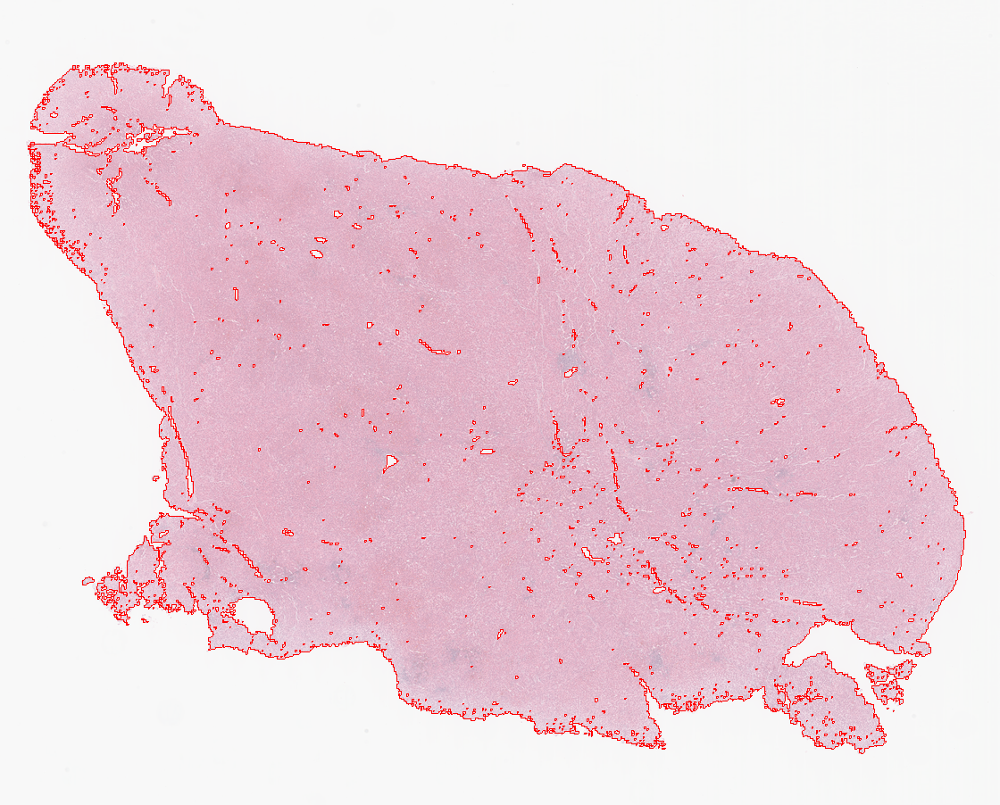

(1805, 2241, 3)
2364


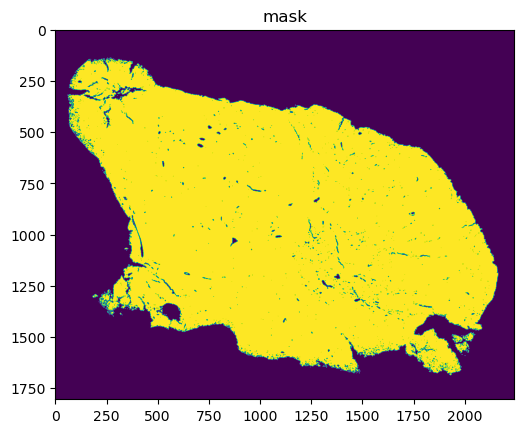

In [ ]:
#HARDCODED i VALUES
# from histolab.data import breast_tissue_diagnostic_green_pen
seed = 0
np.random.seed(seed) 

def tiling_multi(base_dir, output_dir, i):
    files = []
    for level in ['top', 'bot']:
        zipped_names = extremes_dict[f'{gene}_{level}_fnames'].items()
        zipped_names = sorted(zipped_names, key = lambda zipped_names: zipped_names[0])
        files_half = [v for k, v in zipped_names]
        files.extend(files_half)

    for fpath in files:
        process_path = output_dir

        TCGA_slide = Slide(fpath, processed_path=process_path)

        # _, slide_path = breast_tissue_diagnostic_green_pen()
        # breast_slide = Slide(slide_path, "")

        mask = TissueMask(
           RgbToGrayscale(),
           OtsuThreshold())

        display(TCGA_slide.locate_mask(mask, scale_factor=64))


        im = TCGA_slide.resampled_array()
        percent_inference = 0.1
        print(im.shape)


        imInput = cv2.cvtColor(np.array(im), cv2.COLOR_RGB2BGR)
        imInput = cv2.GaussianBlur(imInput,(5,5),0)

        thr=cv2.cvtColor(imInput,cv2.COLOR_RGB2GRAY)

        r,thr=cv2.threshold(thr,0,255,cv2.THRESH_OTSU)        
        thr=cv2.bitwise_not(thr)

        plt.imshow(thr)

        squares = TCGA_slide.dimensions[0]/296* TCGA_slide.dimensions[1]/296
        tissue_pixels = np.sum(thr==255)
        actual_pixels = np.sum(thr==0)
        ratio_pixels = tissue_pixels/(tissue_pixels+actual_pixels)
        no_of_squares = int(ratio_pixels * squares)

        n_tiles = int(no_of_squares *percent_inference)
        print(n_tiles)

        plt.title('mask')
        plt.show()
        grid_tiles_extractor = ScoreTiler(scorer = RandomScorer(),
           tile_size=(296, 296), level=0, n_tiles=n_tiles,
           check_tissue=True,
           tissue_percent = 80,
           pixel_overlap=0, # default
           prefix=f'HE_BC{30000+i}/' , # save tiles in the "grid" subdirectory of slide's processed_path
           suffix=".tif" # default
        )
        grid_tiles_extractor.extract(TCGA_slide)
        create_labels(os.listdir(os.path.join(output_dir,f'HE_BC{30000+i}')), os.path.join(output_dir,f'HE_BC{30000+i}'),i, orig_window)
        print(f'HE_BC{30000+i} created, labels saved')
        i += 1
    return i


i = 50 
for gene in ["ALB", "CD74"]:
    tiling_multi(f"./{gene}_images", "./{gene}_tiled", i)
    i = tiling_multi(f"./{gene}_images", "./{gene}_tiled", i = 50)
    


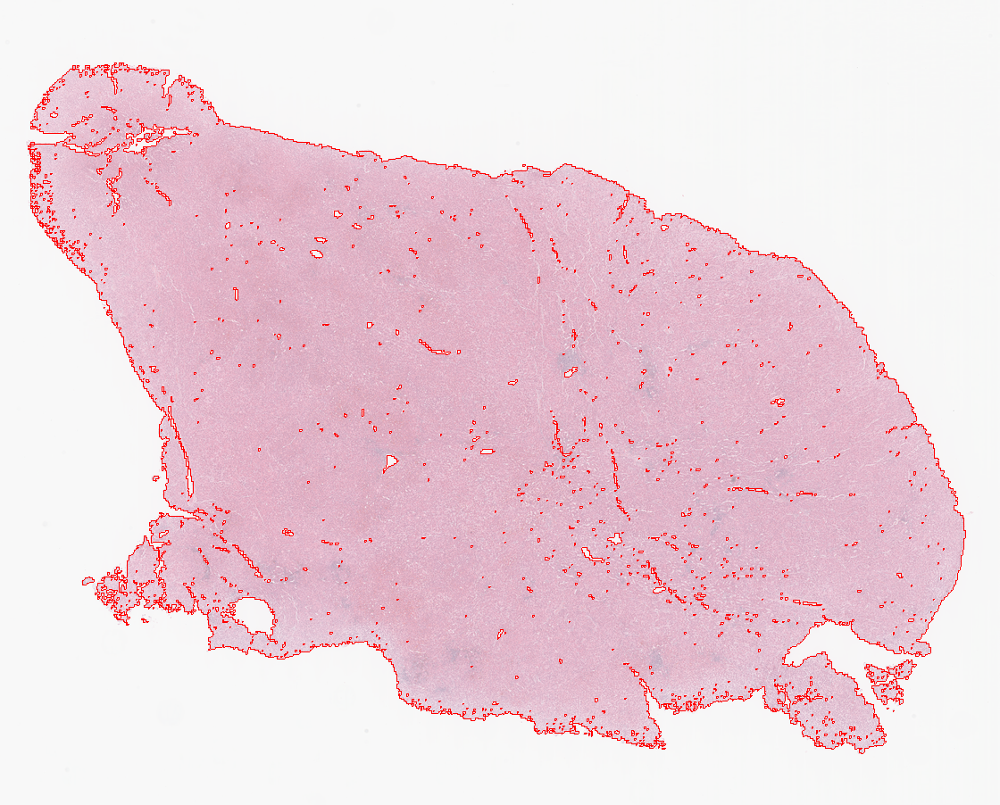

(1805, 2241, 3)
2364


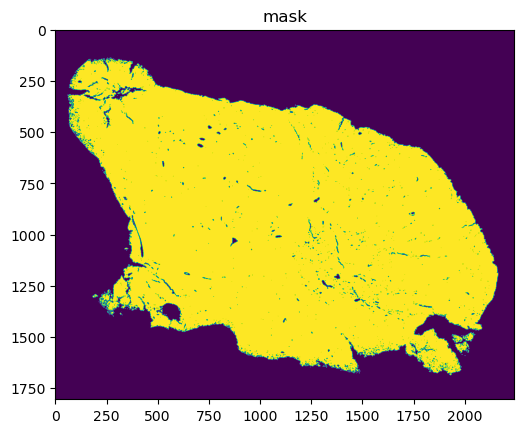

KeyboardInterrupt: 

In [3]:
# #HARDCODED i VALUES
# # from histolab.data import breast_tissue_diagnostic_green_pen
# seed = 0
# np.random.seed(seed) 

# def tiling_multi(base_dir, output_dir, i):

#     for fname in os.listdir(base_dir):
#         TCGA_PATH = os.path.join(base_dir, fname)
#         PROCESS_PATH_TCGA = output_dir

#         TCGA_slide = Slide(TCGA_PATH, processed_path=PROCESS_PATH_TCGA)

#         # _, slide_path = breast_tissue_diagnostic_green_pen()
#         # breast_slide = Slide(slide_path, "")

#         mask = TissueMask(
#            RgbToGrayscale(),
#            OtsuThreshold())

#         display(TCGA_slide.locate_mask(mask, scale_factor=64))


#         im = TCGA_slide.resampled_array()
#         percent_inference = 0.1
#         print(im.shape)


#         imInput = cv2.cvtColor(np.array(im), cv2.COLOR_RGB2BGR)
#         imInput = cv2.GaussianBlur(imInput,(5,5),0)

#         thr=cv2.cvtColor(imInput,cv2.COLOR_RGB2GRAY)

#         r,thr=cv2.threshold(thr,0,255,cv2.THRESH_OTSU)        
#         thr=cv2.bitwise_not(thr)

#         plt.imshow(thr)

#         squares = TCGA_slide.dimensions[0]/296* TCGA_slide.dimensions[1]/296
#         tissue_pixels = np.sum(thr==255)
#         actual_pixels = np.sum(thr==0)
#         ratio_pixels = tissue_pixels/(tissue_pixels+actual_pixels)
#         no_of_squares = int(ratio_pixels * squares)

#         n_tiles = int(no_of_squares *percent_inference)
#         print(n_tiles)

#         plt.title('mask')
#         plt.show()
#         grid_tiles_extractor = ScoreTiler(scorer = RandomScorer(),
#            tile_size=(296, 296), level=0, n_tiles=n_tiles,
#            check_tissue=True,
#            tissue_percent = 80,
#            pixel_overlap=0, # default
#            prefix=f'HE_BC{30000+i}/' , # save tiles in the "grid" subdirectory of slide's processed_path
#            suffix=".tif" # default
#         )
#         grid_tiles_extractor.extract(TCGA_slide)
#         create_labels(os.listdir(os.path.join(output_dir,f'HE_BC{30000+i}')), os.path.join(output_dir,f'HE_BC{30000+i}'),i, orig_window)
#         print(f'HE_BC{30000+i} created, labels saved')
#         i += 1
#     return i


# i = 50 
# for gene in ["ALB", "CD74"]:
#     tiling_multi(f"./{gene}_images", "/home/sam/Desktop/astar/TCGA_test/{gene}_tiled", i)
#     i = tiling_multi(f"./{gene}_images", "/home/sam/Desktop/astar/TCGA_test/{gene}_tiled", i = 50)
    


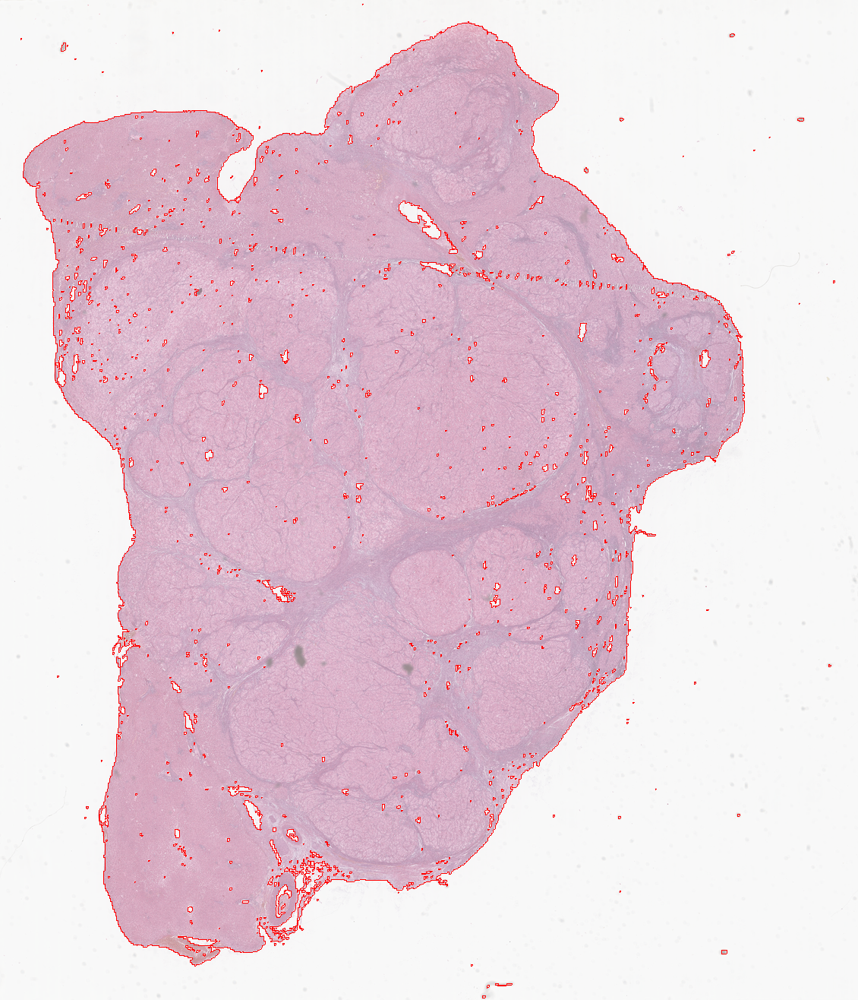

(2632, 2261, 3)
3403


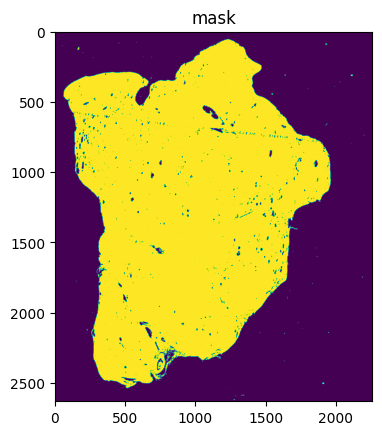

In [8]:
# # from histolab.data import breast_tissue_diagnostic_green_pen
# seed = 0
# np.random.seed(seed) 

# def tiling_multi(base_dir, output_dir):

#     i = 10

#     for fname in os.listdir(base_dir)[:2]:
#         if i == 10:
#             i+=1 
#             pass
#         else:
        
#             TCGA_PATH = os.path.join(base_dir, fname)
#             PROCESS_PATH_TCGA = output_dir

#             TCGA_slide = Slide(TCGA_PATH, processed_path=PROCESS_PATH_TCGA)

#             # _, slide_path = breast_tissue_diagnostic_green_pen()
#             # breast_slide = Slide(slide_path, "")

#             mask = TissueMask(
#                RgbToGrayscale(),
#                OtsuThreshold())

#             display(TCGA_slide.locate_mask(mask, scale_factor=64))


#             im = TCGA_slide.resampled_array()
#             percent_inference = 0.1

#             # display(TCGA_slide.show())
#             print(im.shape)

#             # def max99(im):
#             #     l=im.flatten()
#             #     print(len(l))
#             #     return l[list(l).index(sorted(l)[round(0.99*len(l))])]

#             # # imInput = skimage.io.imread(inputImageFile)[:,:,:3]
#             # _,th = cv2.threshold(img,0,255,cv2.THRESH_BINARY+cv2.THRESH_OTSU)

#             imInput = cv2.cvtColor(np.array(im), cv2.COLOR_RGB2BGR)
#             imInput = cv2.GaussianBlur(imInput,(5,5),0)

#             thr=cv2.cvtColor(imInput,cv2.COLOR_RGB2GRAY)

#             r,thr=cv2.threshold(thr,0,255,cv2.THRESH_OTSU)        
#             thr=cv2.bitwise_not(thr)

#             plt.imshow(thr)

#             squares = TCGA_slide.dimensions[0]/296* TCGA_slide.dimensions[1]/296
#             tissue_pixels = np.sum(thr==255)
#             actual_pixels = np.sum(thr==0)
#             ratio_pixels = tissue_pixels/(tissue_pixels+actual_pixels)
#             no_of_squares = int(ratio_pixels * squares)

#             n_tiles = int(no_of_squares *percent_inference)
#             print(n_tiles)

#             plt.title('mask')
#             plt.show()
#             grid_tiles_extractor = ScoreTiler(scorer = RandomScorer(),
#                tile_size=(296, 296), level=0, n_tiles=n_tiles,
#                check_tissue=True,
#                tissue_percent = 80,
#                pixel_overlap=0, # default
#                prefix=f'HE_BC{30000+i}/' , # save tiles in the "grid" subdirectory of slide's processed_path
#                suffix=".tif" # default
#             )
#             grid_tiles_extractor
# #             grid_tiles_extractor.extract(TCGA_slide)
# #         tile_images(os.listdir(os.path.join(output_dir,f'HE_BC{30000+i}')), os.path.join(output_dir,f'HE_BC{30000+i}'),i, orig_window)
# #         print(f'HE_BC{30000+i} created, labels saved')
# #         i += 1

# tiling_multi("/home/sam/Desktop/astar/TCGA_test/ALB", "/home/sam/Desktop/astar/TCGA_test/ALB_tiled")


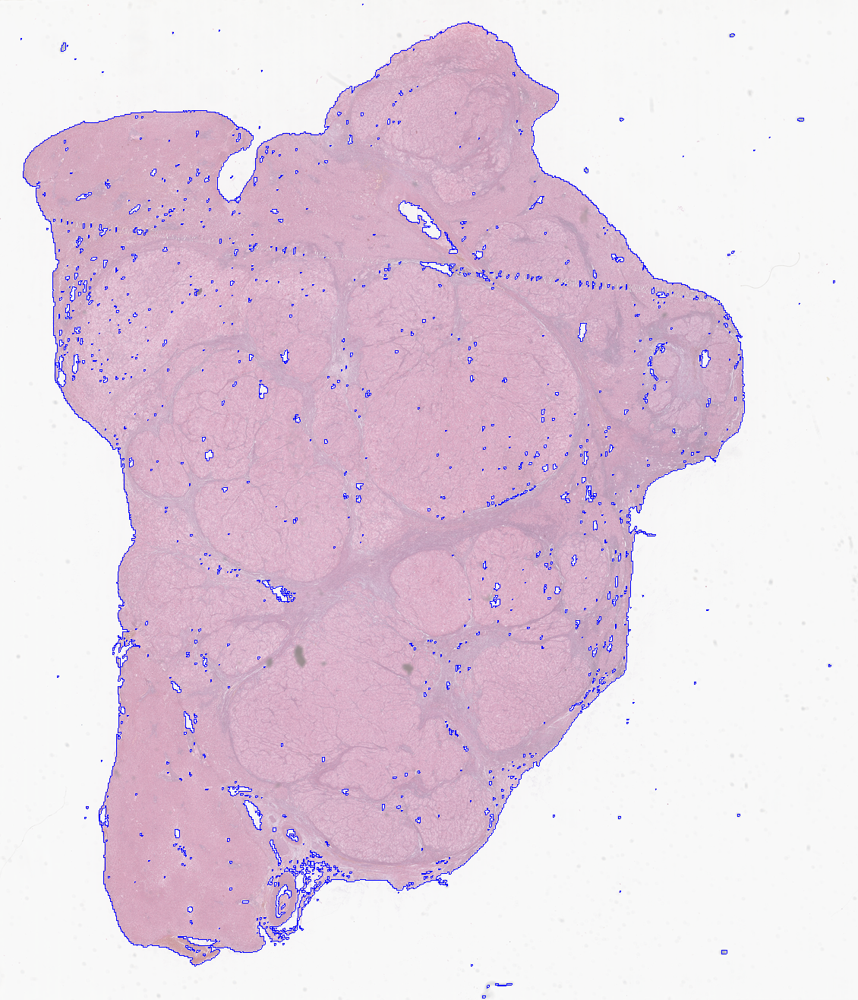

(2632, 2261, 3)
3403


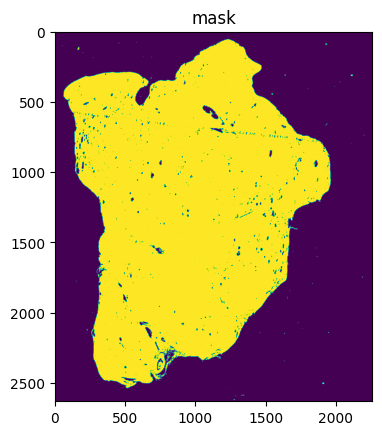

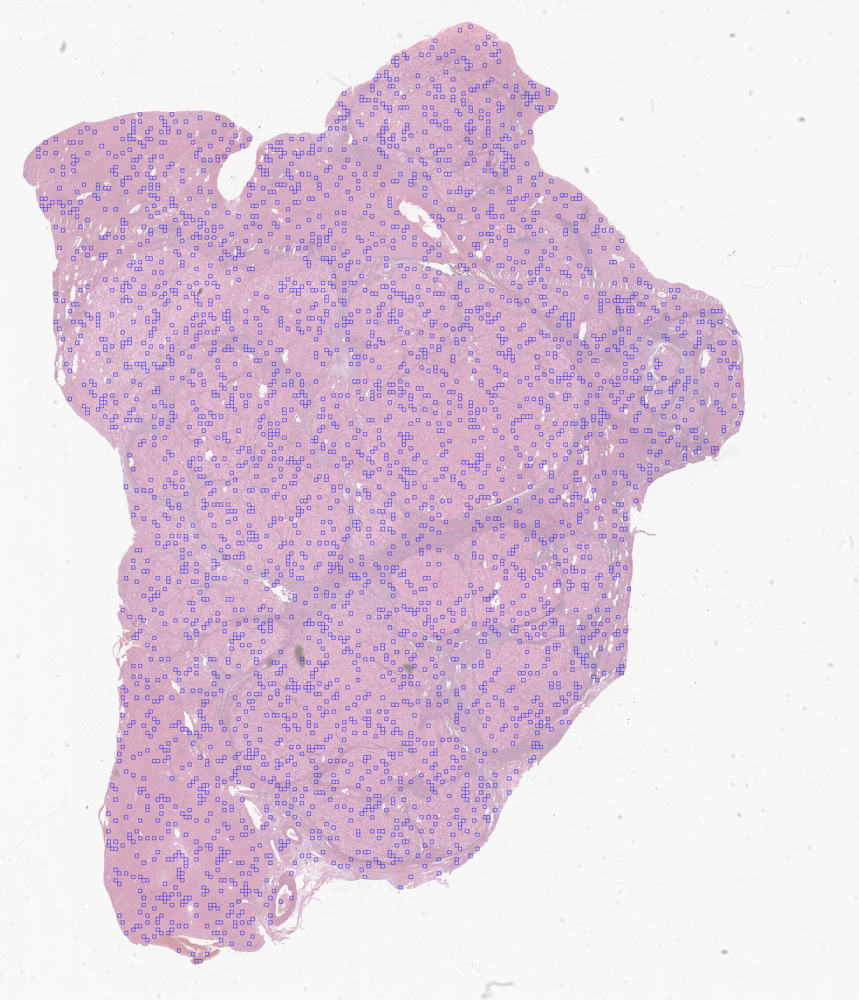

In [15]:
# i = 10
# base_dir = "/home/sam/Desktop/astar/TCGA_test/ALB"
# output_dir = "/home/sam/Desktop/astar/TCGA_test/ALB_tiled"


# fname = os.listdir(base_dir)[1]


# TCGA_PATH = os.path.join(base_dir, fname)
# PROCESS_PATH_TCGA = output_dir

# TCGA_slide = Slide(TCGA_PATH, processed_path=PROCESS_PATH_TCGA)

# # _, slide_path = breast_tissue_diagnostic_green_pen()
# # breast_slide = Slide(slide_path, "")

# mask = TissueMask(
#    RgbToGrayscale(),
#    OtsuThreshold())

# display(TCGA_slide.locate_mask(mask, scale_factor=64, outline = "blue"))


# im = TCGA_slide.resampled_array()
# percent_inference = 0.1

# # display(TCGA_slide.show())
# print(im.shape)

# # def max99(im):
# #     l=im.flatten()
# #     print(len(l))
# #     return l[list(l).index(sorted(l)[round(0.99*len(l))])]

# # # imInput = skimage.io.imread(inputImageFile)[:,:,:3]
# # _,th = cv2.threshold(img,0,255,cv2.THRESH_BINARY+cv2.THRESH_OTSU)

# imInput = cv2.cvtColor(np.array(im), cv2.COLOR_RGB2BGR)
# imInput = cv2.GaussianBlur(imInput,(5,5),0)

# thr=cv2.cvtColor(imInput,cv2.COLOR_RGB2GRAY)

# r,thr=cv2.threshold(thr,0,255,cv2.THRESH_OTSU)        
# thr=cv2.bitwise_not(thr)

# plt.imshow(thr)

# squares = TCGA_slide.dimensions[0]/296* TCGA_slide.dimensions[1]/296
# tissue_pixels = np.sum(thr==255)
# actual_pixels = np.sum(thr==0)
# ratio_pixels = tissue_pixels/(tissue_pixels+actual_pixels)
# no_of_squares = int(ratio_pixels * squares)

# n_tiles = int(no_of_squares *percent_inference)
# print(n_tiles)

# plt.title('mask')
# plt.show()
# grid_tiles_extractor = ScoreTiler(scorer = RandomScorer(),
#    tile_size=(296, 296), level=0, n_tiles=n_tiles,
#    check_tissue=True,
#    tissue_percent = 80,
#    pixel_overlap=0, # default
#    prefix=f'HE_BC{30000+i}/' , # save tiles in the "grid" subdirectory of slide's processed_path
#    suffix=".tif" # default
# )
# grid_tiles_extractor.locate_tiles(
#     slide=TCGA_slide,
#     extraction_mask=mask,
#     outline= "blue"
# )

In [ ]:
# def tile_images(img_list, img_dir, i, orig_window):
#     data_list = [] 
#     data_dict = {}
# #     new_dir = os.path.join(os.path.abspath(os.path.join(img_dir, os.pardir)),f"HE_BC{30000+i}/")
# #     os.rename(img_dir, new_dir)
#     for img in img_list:
#         print(img)
#         if img.endswith(".tif"):
#             info = img.split("_")
#             coord_info = info[3].split("-")
#             col = int(coord_info[0])//orig_window
#             row = int(coord_info[1])//orig_window
#             # BC30001_99_59.tif

#             data_dict = {"label": f"BC{30000+i}", "x_coords" : col, "y_coords" : row, "x_pixel_coords" : coord_info[0], "y_pixel_coords" : coord_info[1]}
#             data_list.append(data_dict)
# #             print(os.path.join(new_dir, f"{data_dict['label']}_{col}_{row}.tif"))
#             os.rename(os.path.join(img_dir, img), os.path.join(img_dir, f"{data_dict['label']}_{col}_{row}.tif"))
#     df = pd.DataFrame(data_list)
#     df.to_csv(os.path.join(img_dir,"..", f"BC{30000+i}_labels.csv"))
#     print(f"BC{30000+i}_labels.csv Saved")
    
    
    
# tile_images(os.listdir(os.path.join(output_dir,f'HE_BC{30000+i}')), os.path.join(output_dir,f'HE_BC{30000+i}'),i, orig_window)

In [ ]:
# # convert the image to grayscale
# gray_image = skimage.color.rgb2gray(maize_roots)

# # blur the image to denoise
# blurred_image = skimage.filters.gaussian(gray_image, sigma=1.0)

# # show the histogram of the blurred image
# histogram, bin_edges = np.histogram(blurred_image, bins=256, range=(0.0, 1.0))
# fig, ax = plt.subplots()
# plt.plot(bin_edges[0:-1], histogram)
# plt.title("Graylevel histogram")
# plt.xlabel("gray value")
# plt.ylabel("pixel count")
# plt.xlim(0, 1.0)

In [ ]:
# import histomicstk as htk
# from histomicstk.preprocessing.color_conversion import rgb_to_lab, lab_to_rgb, rgb_to_sda, sda_to_rgb
# import numpy as np
# import matplotlib.pyplot as plt
# import skimage.io
# from skimage.exposure import match_histograms
# import cv2
# import os
# import playsound
# import math

# #classes & funcs

# #fill
# def imfill(im):
#     th,imth=cv2.threshold(im,220,255,cv2.THRESH_BINARY_INV)
#     imfill=imth.copy()
#     mask=np.zeros((imth.shape[0]+2,imth.shape[1]+2),np.uint8)
#     cv2.floodFill(imfill,mask,(0,0),255)
#     imfill=cv2.bitwise_not(imfill)
#     return cv2.bitwise_or(imth,imfill)

# def binarymetrics(a,b):
#     T=a.shape[0]*a.shape[1]
#     PP=np.sum(a.flatten())/255
#     PN=T-PP
#     P=np.sum(b.flatten())/255
#     N=T-P
#     unequal=cv2.bitwise_and(a,cv2.bitwise_not(b))
#     FP=sum(unequal.flatten())/255
#     unequal=cv2.bitwise_and(b,cv2.bitwise_not(a))
#     FN=sum(unequal.flatten())/255
#     fpr=FP/N #calc
#     fnr=FN/P
#     f1=1-(fpr+fnr)/2
#     precision=1-FP/PP
#     recall=1-FN/P
#     f2=5/(4/precision+1/recall)
#     return fpr, fnr, f1, precision, recall, f2

# def max99(im):
#     l=im.flatten()
#     return l[list(l).index(sorted(l)[round(0.99*len(l))])]


# def ml(deconv_result,i):
#     #use after deconv
#     img=deconv_result.Stains[:,:,i]
#     img=cv2.cvtColor(img,cv2.COLOR_GRAY2RGB)
#     img=rgb_to_sda(img,I_0)
#     return img, max99(img)

# def targetStats(im):
#     pass
    
# '''
# def normalize(im,imT,w,wT,I_0,snmf=False)
    

#     imgs=[]
#     for i in 0,1:
#         if not snmf:
#             channel = htk.preprocessing.color_deconvolution.find_stain_index(stain_color_map[stains[i]], w)
#             channelT = htk.preprocessing.color_deconvolution.find_stain_index(stain_color_map[stains[i]], wT)
            
#         else:
#             channel,channelT=i,i #snmf
        
#         #deconv
#         img,max1=separate(im,channel)
#         _,maxT=separate(imT,channelT)
#         img=cv2.cvtColor(img,cv2.COLOR_GRAY2RGB)
        
#         img=rgb_to_sda(img,I_0) #note: bc inbuilt deconvolution used rgb_to_od, equivalent to stain darkness (sda) space

#         #Max intensity of stain
#         maxl=np.max(img.flatten())
#         maxT=np.max(imgT.flatten())

#         #define stain vector
#         vec=wT.T[channelT] #calculated
#         #vec=stain_color_map[stains[i]] #standard
#         #vec=[1,1,1] #placeholder
        
#         if i==0: #TODO: change func
#             img = np.multiply(img, vec)/maxl*225
#         elif i==1:
#             img=np.multiply(img,vec)/maxl*110
#         imgs.append(img)
    
# '''
# #constants
# stain_color_map = htk.preprocessing.color_deconvolution.stain_color_map

# stains = ['hematoxylin', 'eosin', 'null']

# #DIR='TNBC_NucleiSegmentation' #dirs
# #DIR='MoNuSeg 2018 Training Data/Tissue Images'
# #DIR='Stardist Images'
# #DIR='TNBC-TMA/he'
# #DIR='to normalize'
# DIR='HE_BC30005'

# #stains stat thingy
# w = {0:[], 1:[], 2:[]}

# #nuclei segmentation stuff
# fpr,fnr,fone,precision,recall,ftwo=[],[],[],[],[],[]

# #SNMF things
# sparsity_factor=0.5
# W = np.array([stain_color_map[st] for st in stains]).T
# W_init = W[:, :2]

# #target
# targetpath='MoNuSeg 2018 Training Data/Tissue Images/TCGA-FG-A87N-01Z-00-DX1.tif'
# targetpath='HE_BC30001_C1.tif'

# imT=skimage.io.imread(targetpath)
# imT=cv2.resize(imT,(1000,1000))
# imT=imT[130:-160,88:-164]
# plt.figure()
# #cv2.imshow('target', cv2.cvtColor(imT, cv2.COLOR_RGB2BGR))
# I_0=max99(imT)

# print(I_0)

# w_T=htk.preprocessing.color_deconvolution.rgb_separate_stains_macenko_pca(imT, I_0) #macenko
# #w_T=np.array([stain_color_map[st] for st in stains]).T #standard
# #w_T = htk.preprocessing.color_deconvolution.separate_stains_xu_snmf(imT, W_init, sparsity_factor) #snmf

# #w_T[w_T<0]=0


# print('target')
# print(w_T)

# maxs=[]
# deconv_result = htk.preprocessing.color_deconvolution.color_deconvolution(imT, w_T, I_0)
# for i in 0,1:
#     channel = htk.preprocessing.color_deconvolution.find_stain_index(stain_color_map[stains[i]], w_T.T)
#     #channel=i
#     #deconv
#     _,maxl=ml(deconv_result,channel)
#     maxs.append(maxl)
# print(maxs)

# #imT=rgb_to_lab(imT)
# mu=[np.mean(np.setdiff1d(imT[:,:,i].flatten(),np.array(255))) for i in (0,1,2)]
# sigma=[np.std(np.setdiff1d(imT[:,:,i].flatten(),np.array(255))) for i in (0,1,2)]


# for root,dirs,files in os.walk(DIR):
#     for f in files:
#         plt.figure()
#         imgs = []
#         #gimgs=[]

#         #input
#         #inputImageFile = (DIR+"/"+f2)  # H&E.png
#         inputImageFile = (root+'/'+f)  # H&E.png

#         imInput = skimage.io.imread(inputImageFile)[:,:,:3]
#         try:
            
#             #imInput=cv2.resize(imInput,(imInput.shape[1]//3,imInput.shape[0]//3))
#             thr=cv2.cvtColor(imInput,cv2.COLOR_RGB2GRAY)
#             r,thr=cv2.threshold(thr,max99(thr),255,cv2.THRESH_BINARY)        
#             thr=cv2.bitwise_not(thr)
#             print(imInput.shape,imInput.dtype)
#             #imInput = cv2.imread(inputImageFile)#[1000:2000, 1000:2000, :3]
#             #imInput = cv2.cvtColor(imInput, cv2.COLOR_BGR2RGB)
            
#             cv2.imshow('original', cv2.cvtColor(imInput, cv2.COLOR_RGB2BGR))

#             #Estimate I_0, 99th percentile
#             I_0=max99(imInput)
            
#             #find stain vectors
#             w_est = htk.preprocessing.color_deconvolution.rgb_separate_stains_macenko_pca(imInput, I_0) #macenko
#             #w_est=np.array([stain_color_map[st] for st in stains]).T #standard
#             #w_est = htk.preprocessing.color_deconvolution.separate_stains_xu_snmf(imInput, W_init, sparsity_factor) #snmf
#             #w_est[w_est<0]=0

#             print('original')
#             print(w_est)
            
#             w_est2=[] #modified

#             #deconv
#             deconv_result = htk.preprocessing.color_deconvolution.color_deconvolution(imInput, w_est, I_0)

#             #check calc
#             #print(deconv_result)
#             #print('Estimated stain colors (rows):', w_est.T[:2], sep='\n')
            
#             # Display results
#             for i in 0,1:
#                 # Unlike SNMF, we're not guaranteed the order of the different stains.
#                 # find_stain_index guesses which one we want
                
#                 channel = htk.preprocessing.color_deconvolution.find_stain_index(stain_color_map[stains[i]], w_est.T)
#                 t = htk.preprocessing.color_deconvolution.find_stain_index(stain_color_map[stains[i]], w_T.T)
#                 #channel=i
#                 #t=i
                
#                 #deconv
#                 img,maxl=ml(deconv_result,channel)
                
#                 #define stain vector
#                 vec=w_T.T[t] #use target when normalizing
#                 #vec=stain_color_map[stains[i]] #standard
                
#                 #gimgs.append(img)
                
#                 print(maxl,vec)
                
#                 if i==0 or i==1: #TODO: change func
#                     img = np.multiply(img, vec)/maxl*maxs[i]
#                 imgs.append(img)
#                 cv2.imwrite(stains[i]+"/"+f, imgs[i])
#                 cv2.imshow(stains[i], cv2.cvtColor(cv2.convertScaleAbs(sda_to_rgb(imgs[i],None)),cv2.COLOR_RGB2BGR))

#             img=imgs[0]+imgs[1]
#             img=cv2.cvtColor(cv2.convertScaleAbs(sda_to_rgb(img,I_0)),cv2.COLOR_RGB2BGR)
#             cv2.imwrite("normalised/macenko/"+f,img)
#             #cv2.imshow('processed', img)
#             imT=rgb_to_lab(imT)
#             reinhard=cv2.cvtColor(cv2.convertScaleAbs(htk.preprocessing.color_normalization.reinhard(imInput,mu,sigma,mask_out=thr)),cv2.COLOR_RGB2BGR)
#             cv2.imwrite("normalised/reinhard/"+f,reinhard)
#             imT=lab_to_rgb(imT)
#             reinhard=cv2.cvtColor(cv2.convertScaleAbs(match_histograms(imInput.astype('int64'),imT.astype('int64'),channel_axis=-1)),cv2.COLOR_RGB2BGR)
#             cv2.imwrite("normalised/rgb/"+f,reinhard)
#             #cv2.imshow('processed2',reinhard)
#             #cv2.waitKey(0)
#         except:
#             print(f)
#         plt.close()

# #print('fpr',np.mean(fpr),'fnr',np.mean(fnr),'f1',np.mean(fone),'recall',np.mean(recall),'precision',np.mean(precision),'f2',np.mean(ftwo))

# playsound.playsound('./alarm.mp3') #alarm



In [76]:
# import numpy as np
# from PIL import Image

# base_dir = "/home/sam/Desktop/astar/TCGA_test/ALB_tiled/HE_BC30016"

# for fp in os.listdir(base_dir):
#     img = Image.open(os.path.join(base_dir, fp))
# #     display(img)
#     img_flat = np.asarray(img).flatten()
#     if (np.mean(img_flat)<240 and np.std(img_flat)>2):
#         pass
#     else:
#         display(img)
# print('done')


# # !pwd
# # !ls
# # !cd processed/grid && find | wc -l

# # !cd processed && du -sh grid


FileNotFoundError: [Errno 2] No such file or directory: '/home/sam/Desktop/astar/TCGA_test/ALB_tiled/HE_BC30016'

In [ ]:

        
#    tile_images("./processed/grid/", 5, 296)